<a href="https://colab.research.google.com/github/GuilhermeRLDev/DeepLearningExperiments/blob/main/audio_exploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [50]:
!pip install pretty_midi 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [51]:
import librosa as lr 
import pretty_midi as pm
import matplotlib.pyplot as plt
import IPython

In [52]:
#Mount google drive to load dataset
from google.colab import drive
drive.mount("/content/gdrive")


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [53]:
music, sr = lr.load("gdrive/MyDrive/datasets/1727.wav")

In [5]:
print(music)

[-1.0765228e-07  1.5917901e-07 -2.1163784e-07 ...  5.6643145e-08
 -3.5387021e-08  1.7237010e-08]


In [6]:
IPython.display.display(IPython.display.Audio(data=music, rate=sr))


In [8]:
#Short term fourier transform
music_ft = lr.stft(music, sr)
print(music_ft)

[[-1.15368247e-01+0.0000000e+00j -1.49819136e-01+0.0000000e+00j
  -1.74635798e-01+0.0000000e+00j ... -1.59332436e-02+0.0000000e+00j
  -5.46710864e-02+0.0000000e+00j -7.51842111e-02+0.0000000e+00j]
 [ 4.51227389e-02-1.5842904e-17j  7.51875788e-02-3.6278043e-02j
   9.23661962e-02+1.3875428e-02j ... -1.23222789e-03-1.4610948e-02j
   3.58301178e-02-2.3531133e-02j  3.78929563e-02+4.0108068e-03j]
 [-6.71056891e-03-9.0848519e-18j  1.57815516e-02+3.9519150e-02j
  -1.58901662e-02-5.0306451e-02j ...  1.13945855e-02-1.2458436e-03j
  -1.20758982e-02+1.5972782e-02j  3.09526362e-03-1.2533587e-02j]
 ...
 [ 3.57256937e-07+2.0947548e-17j -3.11078395e-07-6.6970735e-08j
   2.92732551e-07+9.0398053e-08j ...  7.83353382e-11-2.6170122e-10j
  -1.09011555e-08-3.6377880e-08j  5.16694314e-08+1.6191665e-07j]
 [-4.11184288e-07+7.8265844e-17j  1.92249416e-08+1.1654938e-07j
  -2.24809298e-07+5.0477162e-08j ...  1.47416648e-10+2.2394199e-11j
   2.26228014e-08-3.0978125e-08j -1.36546035e-07-9.9399728e-08j]
 [ 3.88637

In [11]:
music_ft[0].shape

(1789,)

In [14]:
import numpy as np

def plot_stft(stft_music, s_rate):

  y = np.arange(len(stft_music[0])) /s_rate

  plt.figure((10, 5))
  plt.plot(stft_music[0], y)



/usr/local/lib/python3.8/dist-packages/matplotlib/axes/_axes.py:7592: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


(array([[2.02764799e-15, 3.64234964e-15, 9.81043344e-16, ...,
         6.68746753e-11, 3.72439523e-12, 6.85900717e-12],
        [2.14032370e-15, 4.08248367e-15, 3.55748674e-15, ...,
         6.14201536e-11, 1.04614785e-11, 5.69693671e-12],
        [9.39619354e-16, 5.47285120e-17, 4.35611677e-15, ...,
         1.39793568e-11, 6.59644477e-12, 6.29423060e-13],
        ...,
        [4.55025180e-21, 7.83375355e-21, 6.34777960e-21, ...,
         2.02930302e-19, 1.04395965e-19, 3.38302829e-20],
        [4.56212353e-22, 1.56538744e-23, 4.48630322e-23, ...,
         2.03723245e-21, 9.00106122e-23, 2.22327708e-21],
        [2.95417296e-23, 4.00157964e-23, 2.34074166e-24, ...,
         2.06923709e-21, 2.17781633e-21, 1.41665475e-22]]),
 array([    0.       ,    86.1328125,   172.265625 ,   258.3984375,
          344.53125  ,   430.6640625,   516.796875 ,   602.9296875,
          689.0625   ,   775.1953125,   861.328125 ,   947.4609375,
         1033.59375  ,  1119.7265625,  1205.859375 ,  1291.99

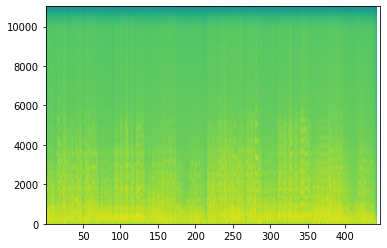

In [20]:
plt.specgram(music, Fs=sr)

In [22]:
a = complex(10, 5)
print(a)

(10+5j)


In [42]:
def generate_figure(f_size=(2, 2), xlim=[0, 1], ylim=[0,1]):
  plt.figure(figsize=f_size)
  plt.xlim(xlim)
  plt.ylim(ylim)
  plt.grid()

  plt.xlabel("Re")
  plt.ylabel("Im")

def plot_vector(c, start=0, linestyle='-', color='k'):
     return plt.arrow(np.real(start), np.imag(start), np.real(c), np.imag(c),
                     linestyle=linestyle, head_width=0.05, fc=color, ec=color, overhang=0.3,
                     length_includes_head=True)



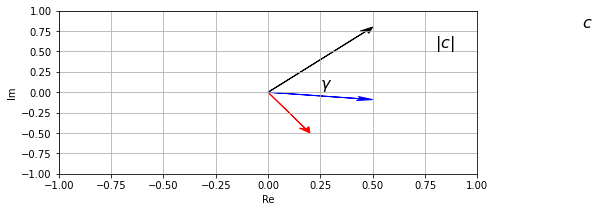

In [49]:
c1 = 0.5 + 0.8j
c2 = 0.2 - 0.5j

c3  = c1 * c2

generate_figure(f_size=(7.5, 3), xlim=[-1, 1], ylim=[-1, 1])
v = plot_vector(c1, color='k')
y = plot_vector(c2, color='r')

y = plot_vector(c3, color='b')

plt.text(1.5, 0.8, '$c$', size='16')
plt.text(0.8, 0.55, '$|c|$', size='16')
plt.text(0.25, 0.05, '$\gamma$', size='16');

In [57]:
print(music_ft.shape)

def get_window(music, window_size):

  total_samples = int(len(music) / window_size)
  print(music.shape[1])
  windows = np.zeros((total_samples, window_size, int(music.shape[1])))
  for i in range(int(total_samples)): 
    size = window_size * i 
    if ( size + window_size <= len(music)):
      windows[i, :,:] = music[size: size + window_size]

  return windows

windows = get_window(np.array(music_ft), 10)

print(windows.shape)


(11026, 1789)
1789


<ipython-input-57-027dbef94631>:11: ComplexWarning: Casting complex values to real discards the imaginary part
  windows[i, :,:] = music[size: size + window_size]


(1102, 10, 1789)
